Δαμιανός Δημήτριος - 03119825
Καπετανάκης Αναστάσιος - 03119048

In [1]:
#imports
import cv2
import numpy as np
import matplotlib.pyplot as plt
import scipy.io
import scipy.stats as stats
from scipy.ndimage import label
from scipy.ndimage import map_coordinates
import matplotlib.pyplot as plt
import matplotlib.patches as patches

%matplotlib inline


Bad key "text.kerning_factor" on line 4 in
C:\Users\munro\anaconda3\envs\cv_lab1_env\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test_patch.mplstyle.
You probably need to get an updated matplotlibrc file from
http://github.com/matplotlib/matplotlib/blob/master/matplotlibrc.template
or from the matplotlib source distribution


In [2]:
### Part1
## read data from .mat file
samples = scipy.io.loadmat('part1 - GreekSignLanguage/skinSamplesRGB.mat')
skin = cv2.cvtColor(samples['skinSamplesRGB'],cv2.COLOR_RGB2YCrCb)
Cb = skin[:,:,1]
Cr = skin[:,:,2]
mean = [np.mean(Cb),np.mean(Cr)]
cov_matrix = np.array(np.cov(Cb.flatten(),Cr.flatten()))

print("mean = ",mean)
print("cov = ",cov_matrix)

mean =  [157.0460157126824, 103.27048260381594]
cov =  [[ 44.19103128 -11.9310385 ]
 [-11.9310385   11.19574811]]


In [3]:
## σκιν δετεψτιον φθνψτιον
def fd(image,mean,cov):
    ## turn image for RGB to YCrCb
    image_to_YCrCb = cv2.cvtColor(image, cv2.COLOR_RGB2YCrCb)
    ## split to channels
    _,Cr,Cb = cv2.split(image_to_YCrCb)
    ## ignore Y channel
    x = np.array([Cr,Cb]).T
    ## create a multivariate matrix of the image
    p = stats.multivariate_normal.pdf(x,mean,cov).T
    ## apply threshold: instead of [0.05, 0.25]->[0.0005,0.25]
    thresh, skin = cv2.threshold(p,0.0005,0.25,cv2.THRESH_BINARY)
    
    ## apply closing and opening
    small_k = np.ones((5,5),np.uint8)
    big_k = np.ones((12,12),np.uint8)
    
    opening = cv2.dilate(cv2.erode(skin, small_k),small_k)
    closing = cv2.morphologyEx(opening, cv2.MORPH_CLOSE, big_k)
    plt.imshow(closing,cmap="gray")
    
    ## find the bounding boxes
    labeled, features = label(closing) ## find all not-backrgound areas and label them
    print("Detected features:",features)
    coordinates = []
    for i in range(features):
        x,y = np.where(labeled == i+1) ## find all (x,y) of the areas with label = i+1
        x = np.sort(x) ## sort x,y
        y = np.sort(y)
        width = x[-1] - x[0] 
        height = y[-1] - y[0]
        coordinates.append([y[0],x[0],height,width])
    return coordinates

Detected features: 3


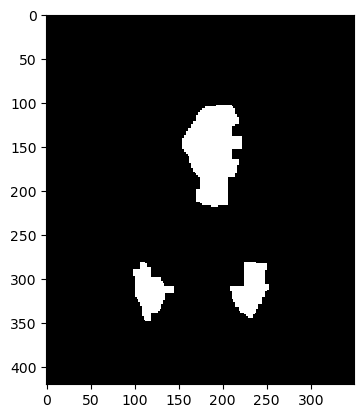

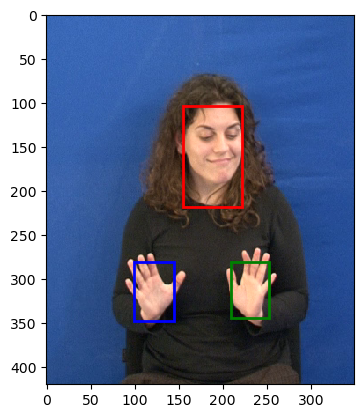

In [4]:
img = cv2.imread("part1 - GreekSignLanguage/1.png")
img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)

f1, f2, f3 = fd(img,mean,cov_matrix)
figure, axis = plt.subplots(1)
axis.add_patch(patches.Rectangle((f1[0],f1[1]),f1[2],f1[3], edgecolor='r', facecolor="none",linewidth=2))
axis.add_patch(patches.Rectangle((f2[0],f2[1]),f2[2],f2[3], edgecolor='b', facecolor="none",linewidth=2))
axis.add_patch(patches.Rectangle((f3[0],f3[1]),f3[2],f3[3], edgecolor='g', facecolor="none",linewidth=2))
axis.imshow(img)
plt.show()

In [63]:
### Part2
## part 1.2.1
def lk(I1,I2,features,rho,epsilon,d_x0,d_y0):
    Iy,Ix=np.gradient(I1)
    
    n = int(np.ceil(3*rho)*2+1)
    g1d = cv2.getGaussianKernel(n,rho)
    g2d = g1d @ g1d.T
    
    d_xi = d_x0
    d_yi = d_y0
    
    h,w = I1.shape
    x_0,y_0=np.meshgrid(np.arange(w),np.arange(h))
    
    for i in range(features.shape[0]):  ## update dx,dy for every features
        x = features[i][0][0].astype(int)
        y = features[i][0][1].astype(int)
        dx = d_x0[y][x]
        dy = d_y0[y][x]
        u = np.array([[0,0]]) 
        dx_prev,dy_prev = 0,0  ## init prev values 
        
        ## 2 different criterions 
        criterion1 = (np.abs(dx-dx_prev)>1e-3) or (np.abs(dy-dy_prev)>1e-3)
        iteration = 0
        criterion2 = iteration<100
        
        while iteration<100:
            iteration+=1       ## uncomment for criterion2
            dx_prev,dy_prev = dx,dy
            
            I_prev = map_coordinates(I1, [y_0 + dy,x_0 + dx], order=1, mode='nearest').reshape(I1.shape)
            A1 = map_coordinates(Ix, [y_0 + dy,x_0+ dx], order=1, mode='nearest').reshape(I1.shape)
            A2 = map_coordinates(Iy, [y_0 + dy,x_0 + dx], order=1, mode='nearest').reshape(I1.shape)
            E = I2 - I_prev
            
            a11 = cv2.filter2D(A1**2,-1,g2d)+epsilon
            a12 = cv2.filter2D(A1*A2,-1,g2d)
            a21 = a12
            a22 = cv2.filter2D(A2**2,-1,g2d)+epsilon
            
            A = np.array([[a11[y,x],a12[y,x]],
                           [a21[y,x],a22[y,x]]])
            
            b11 = cv2.filter2D(A1*E,-1,g2d)
            b21 = cv2.filter2D(A2*E,-1,g2d)
            
            A_inv = np.linalg.inv(A)
            B = np.array([[b11[y,x]],
                          [b21[y,x]]])
            u = np.matmul(A_inv,B)
            
            dx += u[0,0]
            dy += u[1,0]
            
        d_xi[y][x] = -dx
        d_yi[y][x] = -dy
    
    return d_xi,d_yi

In [64]:
### part 1.2.2
def displ(dx,dy):
    thesh = 0.2 ## threshold for choosing valid vectors -> by testing several values 0.2 is best
    d = dx**2+dy**2
    condition = (d >= (thesh * np.max(d))).astype(int) ## binary matrix: 1 where valid, 0 elsewhere 
    dx = condition*dx
    dy = condition*dy ## only the points that survive the condition
    m_dx = np.sum(dx)/np.sum(condition)
    m_dy = np.sum(dy)/np.sum(condition)
    return m_dx,m_dy

In [59]:
## coordinates of each part
face_coord = [154,102,67,115]
right_hand_coord = [93,272,56,83]
left_hand_coord = [201,270,56,83]

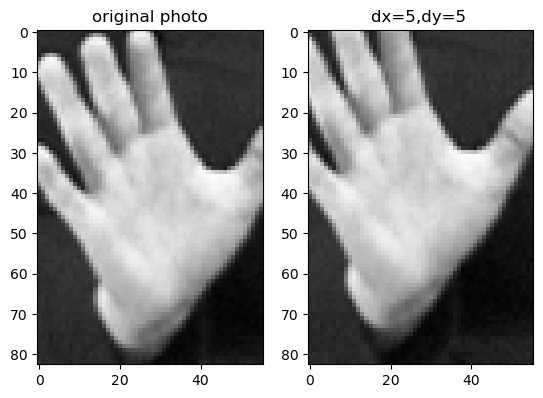

Predicted movement of bounding box: (-5.434014948023747, -5.179426587567348)


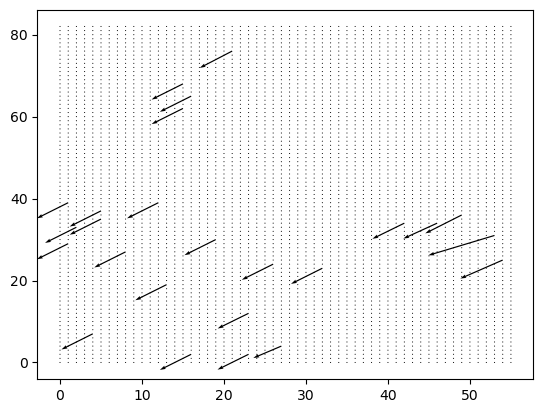

In [9]:
## testing
img = cv2.imread("part1 - GreekSignLanguage/1.png")
gray_img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
gray_img = gray_img.astype(np.float32)/255 #normalize image

## test on left hand
x,y,w,h = right_hand_coord
I1 = gray_img[y:y+h,x:x+w]
I2 = gray_img[y+5:y+h+5,x+5:x+w+5]

'''
plt.imshow(I1,cmap="gray")
plt.show()
'''

feats = cv2.goodFeaturesToTrack(I1,1000,0.1,0.1)
dx0 = np.zeros(I1.shape)
dy0 = np.zeros(I1.shape)

dx,dy = lk(I1,I2,feats,rho=5,epsilon=0.01,d_x0=dx0,d_y0=dy0)

## print results
fig, axis = plt.subplots(1,2)
axis[0].imshow(I1,cmap="gray")
axis[0].set_title("original photo")
axis[1].imshow(I2,cmap="gray")
axis[1].set_title("dx=5,dy=5 ")
plt.show()

'''for x,y in feats[:,0,:].astype(int):
    print(dx[y][x],dy[y][x])'''

print("Predicted movement of bounding box:",displ(dx,dy))

plt.quiver(dx, dy, angles='xy', scale=100)
plt.show()

Predicted movement of bounding box for dx,dy=1: (-1.007175250027978, -1.0029332945514449)


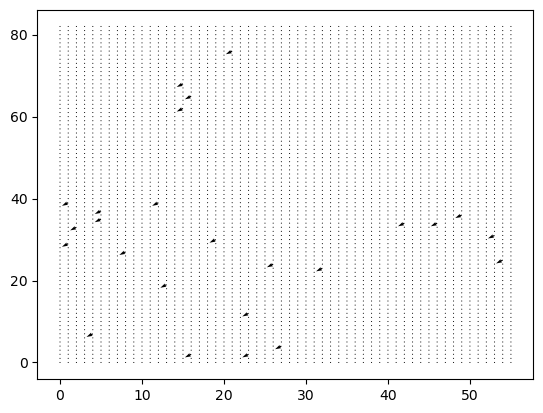

Predicted movement of bounding box for dx,dy=5: (-5.434014948023747, -5.179426587567348)


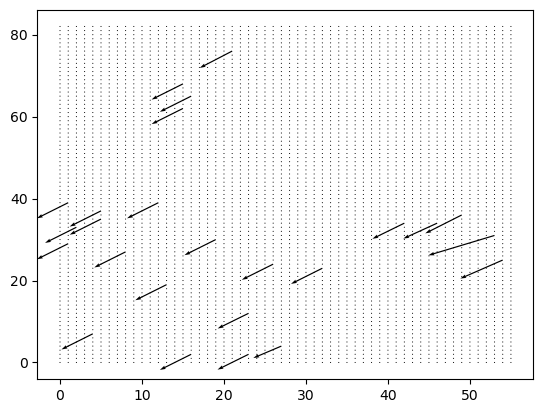

Predicted movement of bounding box for dx,dy=10: (-4.369881076437372, -3.5123258660476893)


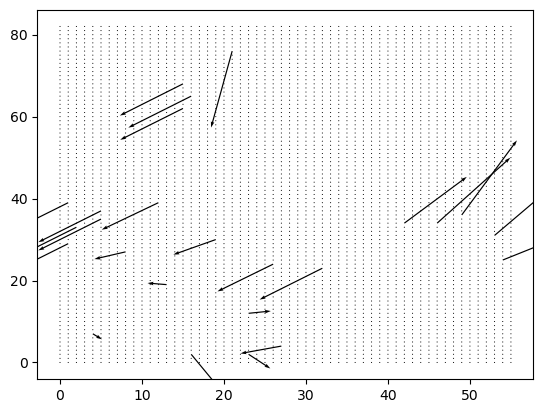

Predicted movement of bounding box for dx,dy=15: (-3.1205029348205726, -3.070097170105916)


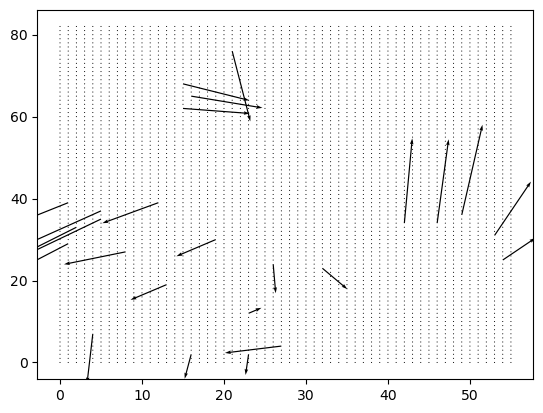

In [10]:
## testing for different dx,dy, to test the limits of lucas-kanade
offset = [1,5,10,15]
for off in offset:
    x,y,w,h = right_hand_coord
    I1 = gray_img[y:y+h,x:x+w]
    I2 = gray_img[y+off:y+h+off,x+off:x+w+off]
    feats = cv2.goodFeaturesToTrack(I1,1000,0.1,0.1)
    dx0 = np.zeros(I1.shape)
    dy0 = np.zeros(I1.shape)
    dx,dy = lk(I1,I2,feats,rho=5,epsilon=0.01,d_x0=dx0,d_y0=dy0)
    print(f"Predicted movement of bounding box for dx,dy={off}:",displ(dx,dy))
    plt.quiver(dx, dy, angles='xy', scale=100)
    plt.show()

Παρατηρούμε ότι μέχρι μετατόπιση 5 έχουμε καλά αποτελέσματα τόσο στο displ(dx,dy) 
και καλή απεικόνιση της μετατόπισης στο quiver. Από κει και πέρα ο αλγόριθμος δυσκολεύεται να βρει καλά αποτελέσματα.

Επίσης, εναλλάσοντας μεταξύ των criterion1-2 στην lk(), παρατηρήσαμε ότι η σύγκλιση των dx,dy για μετατόπιση 10 και 15 αργεί πάρα πολύ.


In [81]:
## tracking all parts with 2 different methods(Lk, and TVL1)
def simple_tracker(limit=70,flow_type=True):
    face_coord = [154,102,67,115]
    right_hand_coord = [93,272,56,83]
    left_hand_coord = [201,270,56,83]
    
    x = np.array([face_coord[0],right_hand_coord[0],left_hand_coord[0]])
    y = np.array([face_coord[1],right_hand_coord[1],left_hand_coord[1]])
    w = np.array([face_coord[2],right_hand_coord[2],left_hand_coord[2]])
    h = np.array([face_coord[3],right_hand_coord[3],left_hand_coord[3]])
    
    def box_tvl1(d): 
        dx= d[:,:,0]
        dy= d[:,:,1]
        d_2 = np.square(dx) + np.square(dy)
        cond = (d_2 > np.mean(d_2)).astype(int)
        rem_dx = dx*cond
        rem_dy = dy*cond
        return (np.mean(rem_dx), np.mean(rem_dy))   
    
    
    for frame in range(1,limit):
        img1 = cv2.imread(f"part1 - GreekSignLanguage/{frame}.png")
        gray_img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2GRAY)
        gray_img1 = gray_img1.astype(np.float32)/255 #normalize image

        img2 = cv2.imread(f"part1 - GreekSignLanguage/{frame+1}.png")
        gray_img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2GRAY)
        gray_img2 = gray_img2.astype(np.float32)/255 #normalize image
        
        for i in range(3):
            I1 = gray_img1[y[i]:y[i]+h[i],x[i]:x[i]+w[i]]
            I2 = gray_img2[y[i]:y[i]+h[i],x[i]:x[i]+w[i]]

            feats = cv2.goodFeaturesToTrack(I1,1000,0.1,0.1)
            dx0 = np.zeros(I1.shape)
            dy0 = np.zeros(I1.shape)
            
            if flow_type:
                dx,dy = lk(I1,I2,feats,rho=5,epsilon=0.01,d_x0=dx0,d_y0=dy0)
                box_x,box_y = displ(dx,dy)
            else:
                opt_flow = cv2.DualTVL1OpticalFlow_create()
                flow = opt_flow.calc(I1,I2,None)
                box_x,box_y = box_tvl1(flow)
            
            x[i] += round(box_x)
            y[i] += round(box_y)
            
        for i in range(3):
            out = cv2.rectangle(img2, ((x[i]),(y[i])), ((x[i])+w[i], (y[i])+h[i]), (255,0,0), 2)

        print(f'Image: {frame}')
        print("Approximate movement of bounding box:",box_x,box_y)
        plt.imshow(img2)
        plt.show()
        

Image: 1
Approximate movement of bounding box: -0.38389414485305184 0.21015660213788057


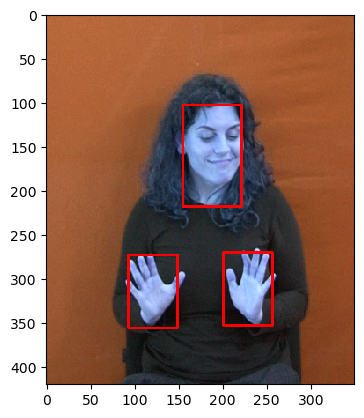

Image: 2
Approximate movement of bounding box: -0.4750854080458137 0.07707989634937402


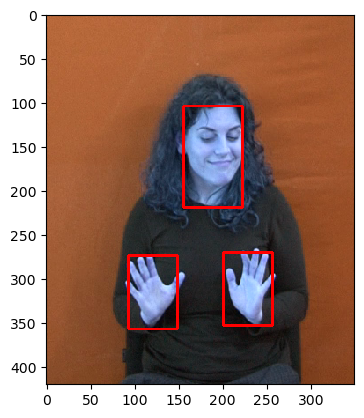

Image: 3
Approximate movement of bounding box: -0.507042637754617 0.017022495487284496


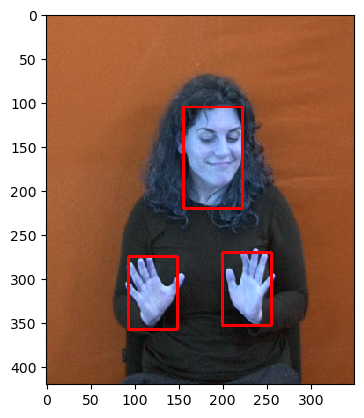

Image: 4
Approximate movement of bounding box: -0.5400411309754287 -0.045362321664182574


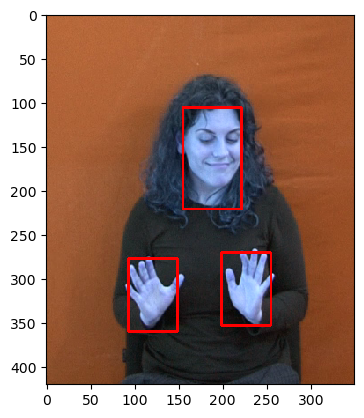

Image: 5
Approximate movement of bounding box: -0.4307862515253997 0.37110195583013594


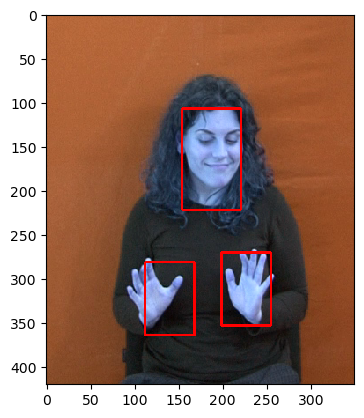

Image: 6
Approximate movement of bounding box: -0.7174370221689571 0.8480653091890076


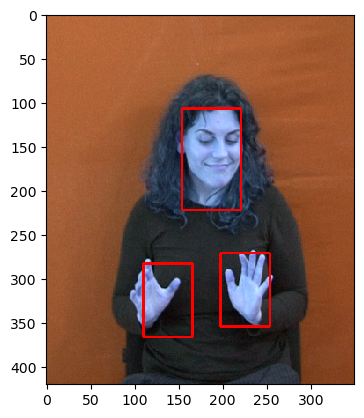

Image: 7
Approximate movement of bounding box: -2.1002680488941206 1.3660905956049563


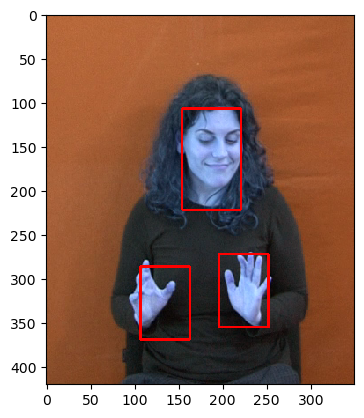

Image: 8
Approximate movement of bounding box: -3.2062161194210863 2.202272339991547


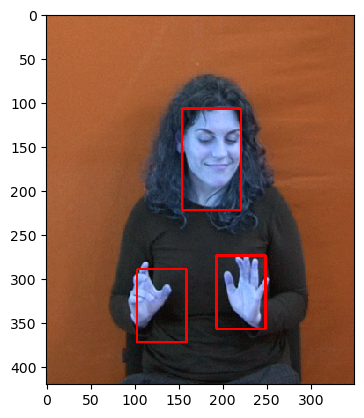

Image: 9
Approximate movement of bounding box: 4.001097574830055 54.876505732536316


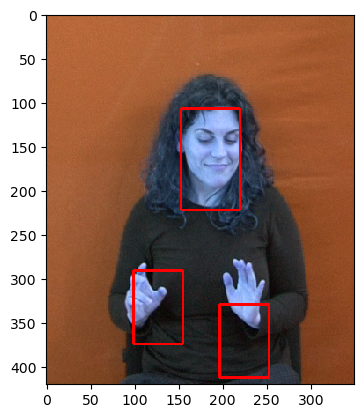

Image: 10
Approximate movement of bounding box: -0.882939432956093 0.7956503220849921


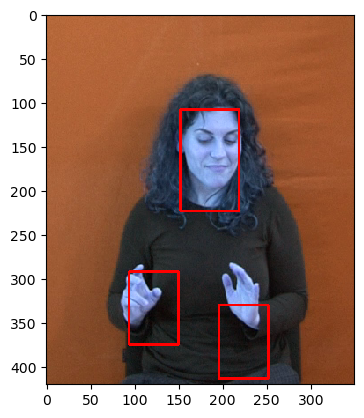

Image: 11
Approximate movement of bounding box: -1.1112666771323396 0.9268548938862633


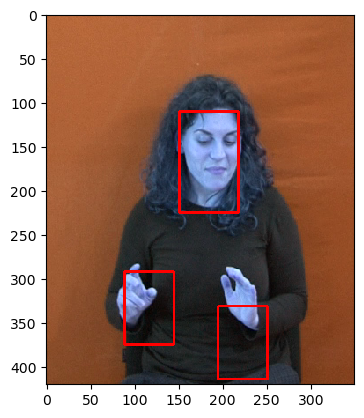

Image: 12
Approximate movement of bounding box: -1.0627510044747883 0.5957409756534027


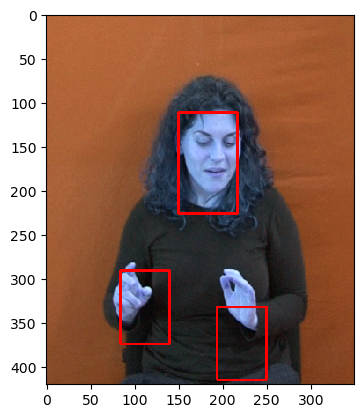

Image: 13
Approximate movement of bounding box: -0.844541154955803 0.4326501468532529


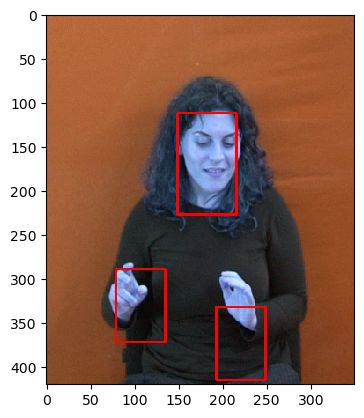

Image: 14
Approximate movement of bounding box: -0.9296879441734484 0.8137071881099927


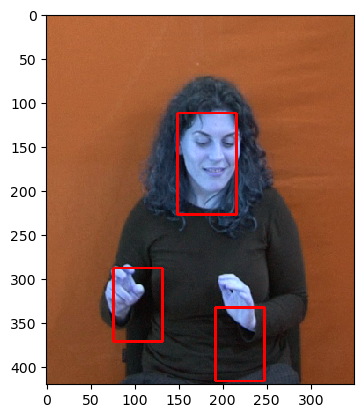

Image: 15
Approximate movement of bounding box: -1.1910533897388884 0.6383725536935708


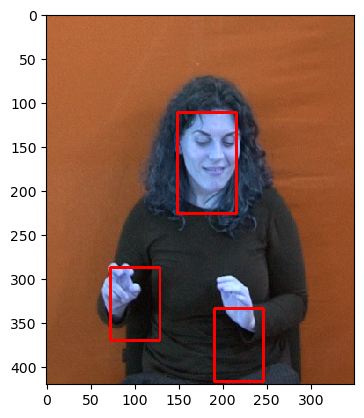

Image: 16
Approximate movement of bounding box: -1.3728506579932322 0.3800859421069602


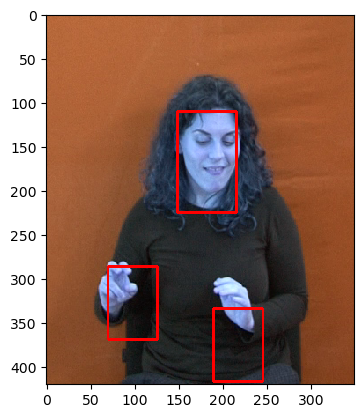

Image: 17
Approximate movement of bounding box: -1.4466472740303822 0.421833004658158


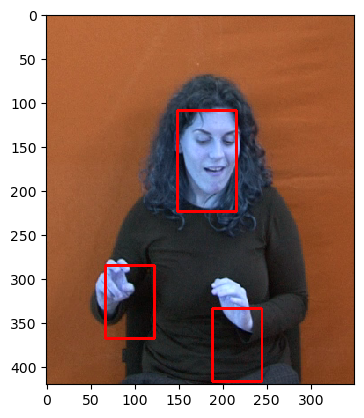

Image: 18
Approximate movement of bounding box: -0.8934785014466671 0.26186646277916353


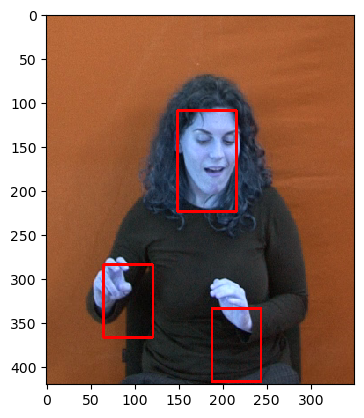

Image: 19
Approximate movement of bounding box: -0.39125787611482793 0.37990439055132325


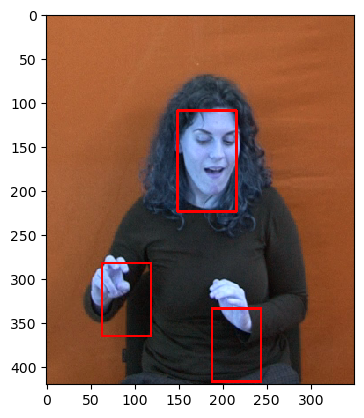

Image: 20
Approximate movement of bounding box: 0.06926593639794797 0.43650739626537344


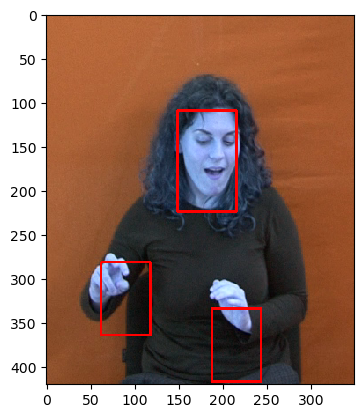

Image: 21
Approximate movement of bounding box: 0.33712133850983755 0.11338177475823911


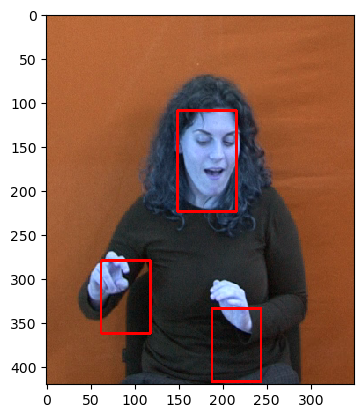

Image: 22
Approximate movement of bounding box: 0.4479611647437574 -0.1427042238899651


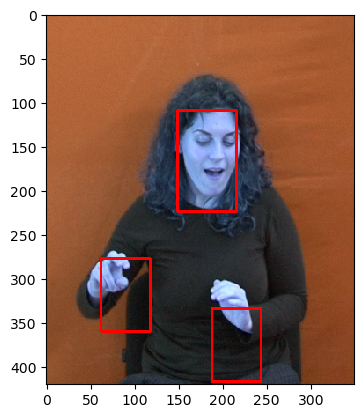

Image: 23
Approximate movement of bounding box: 0.5521403351446923 -0.1215924709750832


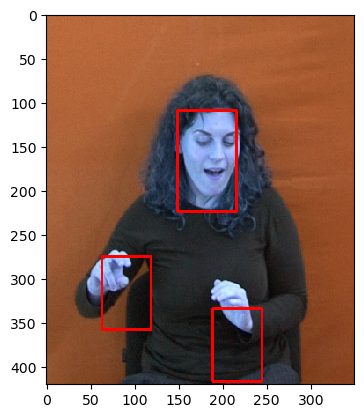

Image: 24
Approximate movement of bounding box: 0.5716440986675817 -0.11220280184228182


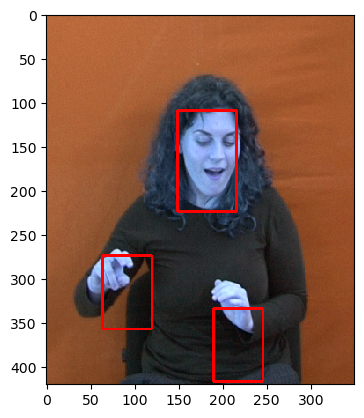

Image: 25
Approximate movement of bounding box: 0.6155176893427098 -0.10060561373297365


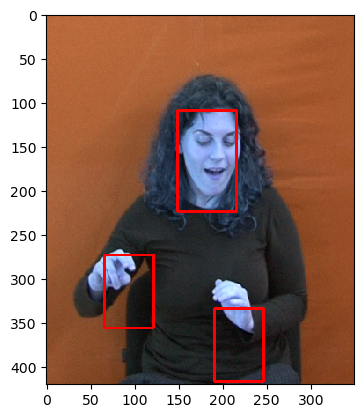

Image: 26
Approximate movement of bounding box: 0.5855896303078216 -0.08954321724957866


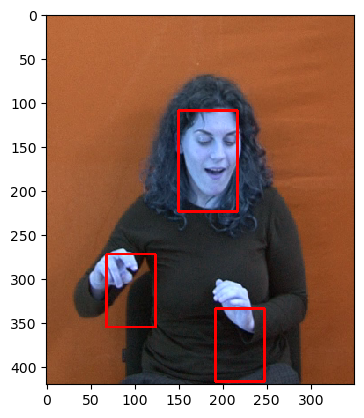

Image: 27
Approximate movement of bounding box: 0.6097317916658368 -0.12328091184046099


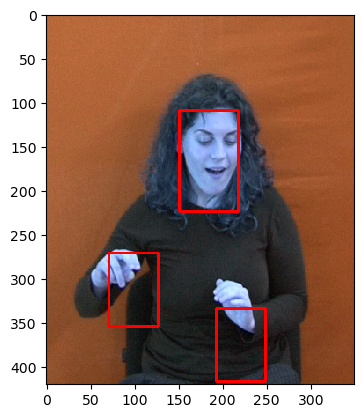

Image: 28
Approximate movement of bounding box: 0.649712675926488 -0.19129164770899065


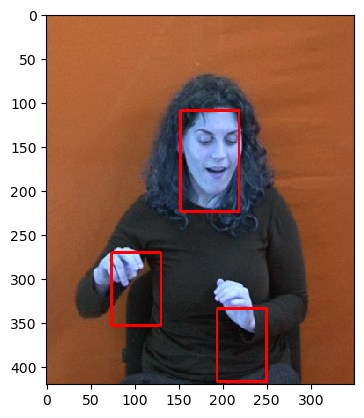

Image: 29
Approximate movement of bounding box: 0.6597348037758429 -0.12096658467001602


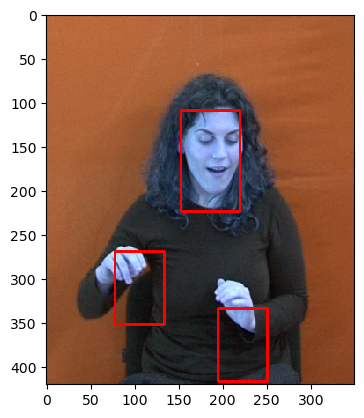

In [68]:
## for rime saving reasons we'll only check the first 30 images
simple_tracker(limit=30)

Image: 1
Approximate movement of bounding box: -0.12633203716368355 0.040602498790393494


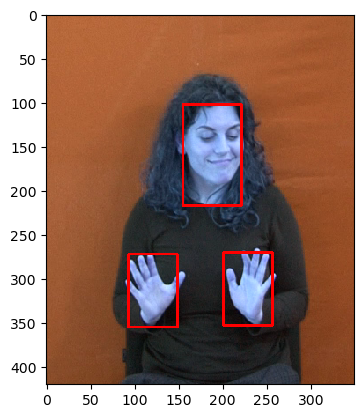

Image: 2
Approximate movement of bounding box: -0.1526877535138401 0.0018781406383439675


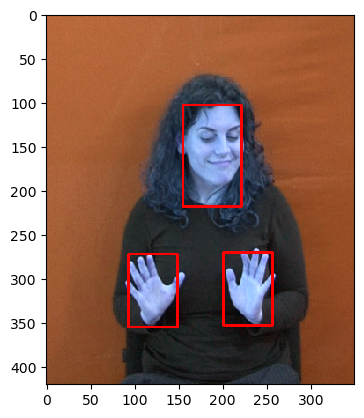

Image: 3
Approximate movement of bounding box: -0.16874553204198303 0.00042986302622938574


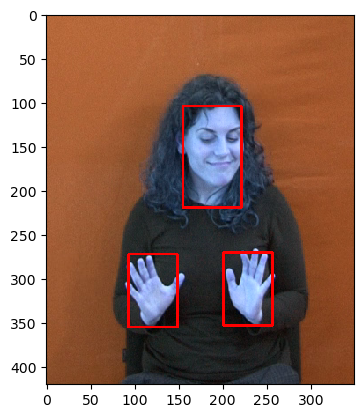

Image: 4
Approximate movement of bounding box: -0.1744884087250483 -0.010590254135211254


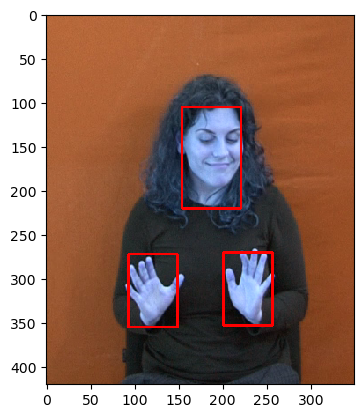

Image: 5
Approximate movement of bounding box: -0.12837548873574825 0.09175217005130859


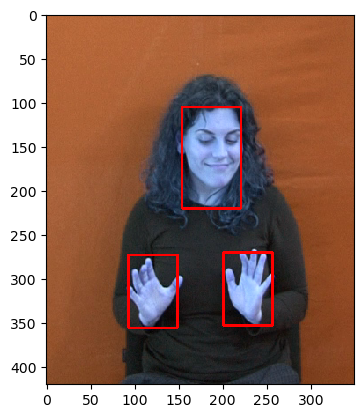

Image: 6
Approximate movement of bounding box: -0.24972120514091445 0.2771167872592217


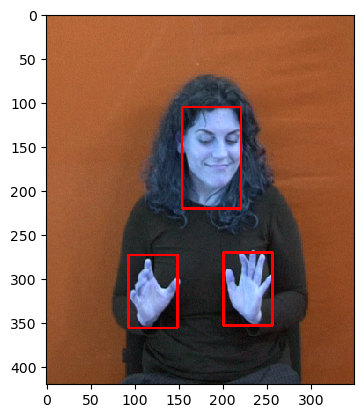

Image: 7
Approximate movement of bounding box: -0.5224210393203105 0.4402338229568608


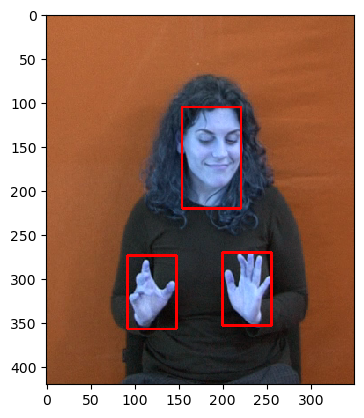

Image: 8
Approximate movement of bounding box: -0.7099327265754625 0.5687509796064405


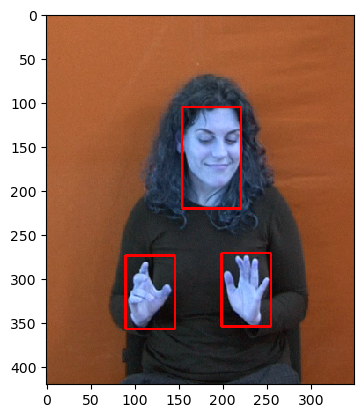

Image: 9
Approximate movement of bounding box: -0.963711360671434 0.6592523500502828


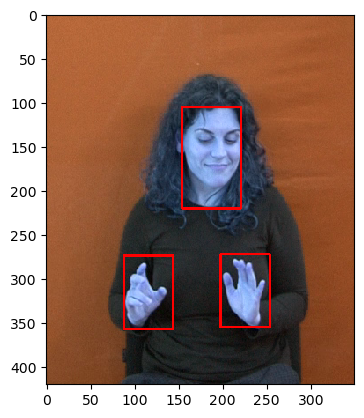

Image: 10
Approximate movement of bounding box: -1.1077578044632728 0.9633891145520798


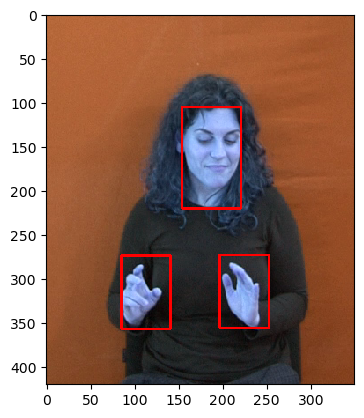

Image: 11
Approximate movement of bounding box: -0.896721001028399 0.8131188397358289


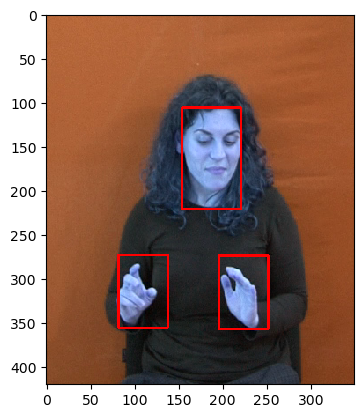

Image: 12
Approximate movement of bounding box: -0.4102290856736919 0.5611194285360548


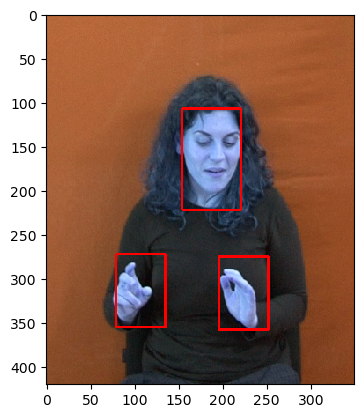

Image: 13
Approximate movement of bounding box: -0.3585218724100602 0.6012681891914079


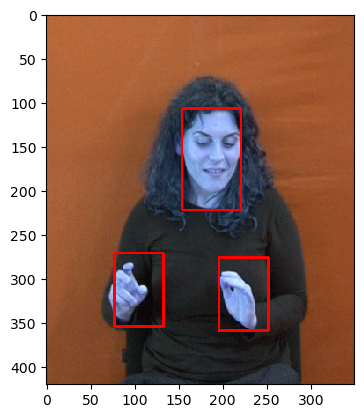

Image: 14
Approximate movement of bounding box: -0.5258981343647289 0.5927584216691131


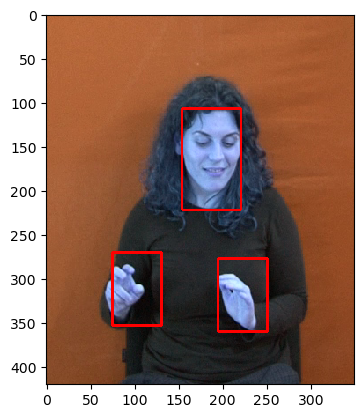

Image: 15
Approximate movement of bounding box: -0.42687849900500907 0.5857105536735817


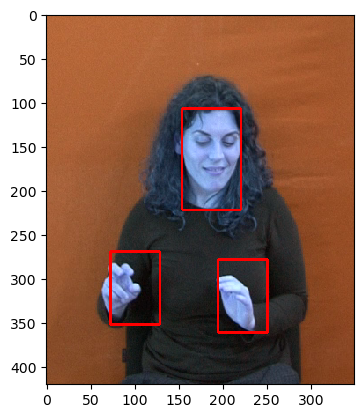

Image: 16
Approximate movement of bounding box: -0.6160836103091757 0.6365347425236965


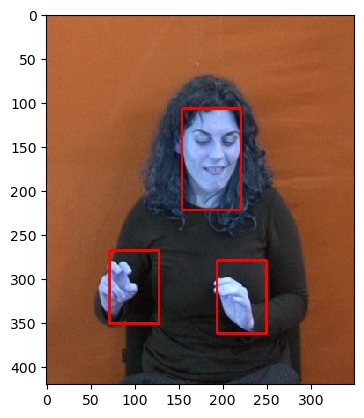

Image: 17
Approximate movement of bounding box: -0.8280841349632112 0.36007827474205095


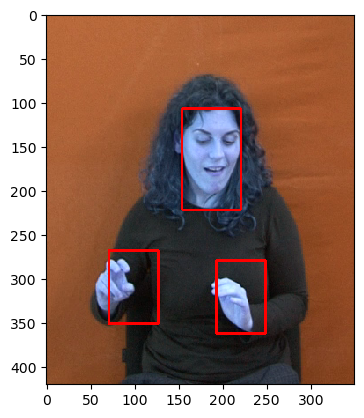

Image: 18
Approximate movement of bounding box: -0.3502241667238242 0.24656141785305255


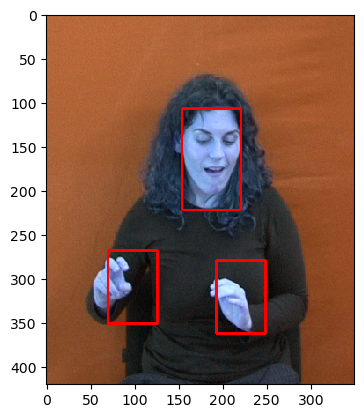

Image: 19
Approximate movement of bounding box: -0.12589080624679896 0.181010588362377


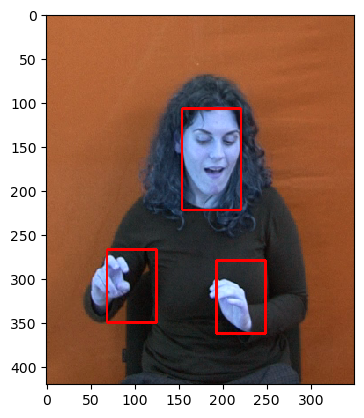

Image: 20
Approximate movement of bounding box: 0.022054440174179662 0.2221964578338211


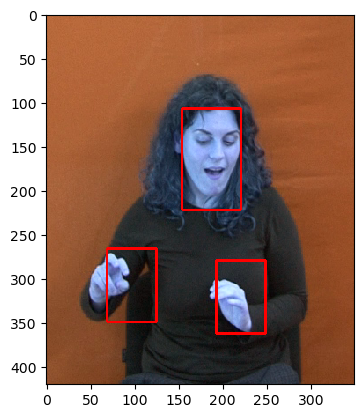

Image: 21
Approximate movement of bounding box: 0.09611618670790413 0.08407855313271284


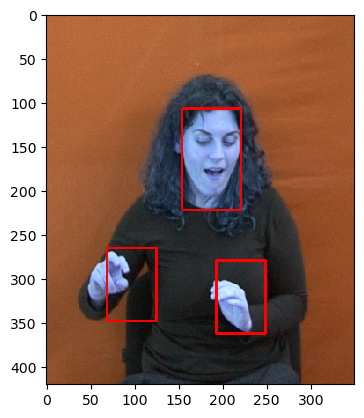

Image: 22
Approximate movement of bounding box: 0.23327107058129498 -0.030015003834987338


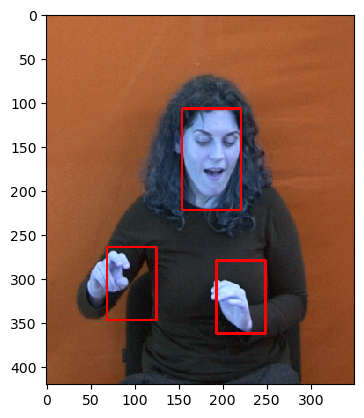

Image: 23
Approximate movement of bounding box: 0.343932827604412 -0.018951971460476023


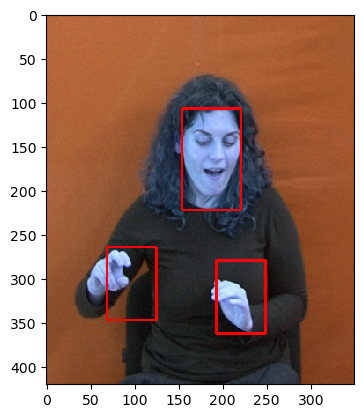

Image: 24
Approximate movement of bounding box: 0.32236653300909496 -0.013151991085098054


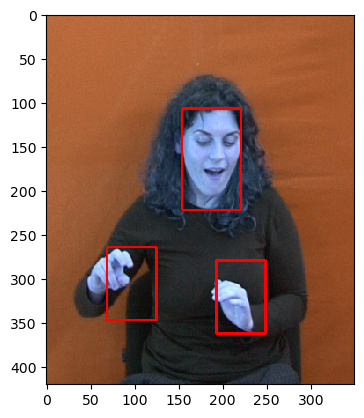

Image: 25
Approximate movement of bounding box: 0.406487660338259 -0.006534071601961343


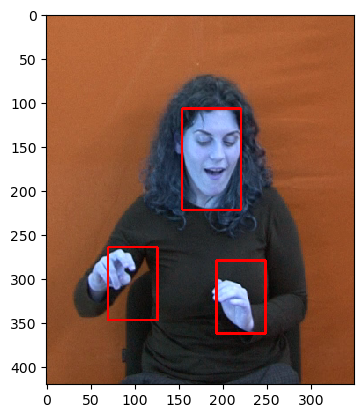

Image: 26
Approximate movement of bounding box: 0.3221539035631847 0.028569179722616887


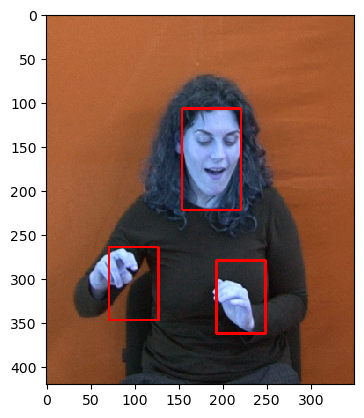

Image: 27
Approximate movement of bounding box: 0.29638221883014637 0.0070687403538037515


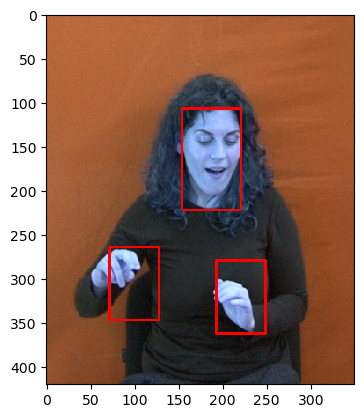

Image: 28
Approximate movement of bounding box: 0.441689452044217 -0.045345723015963936


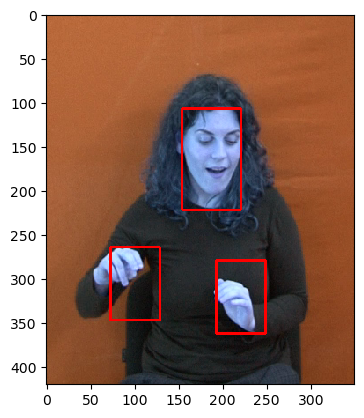

Image: 29
Approximate movement of bounding box: 0.45335200262254366 -0.02592485586683011


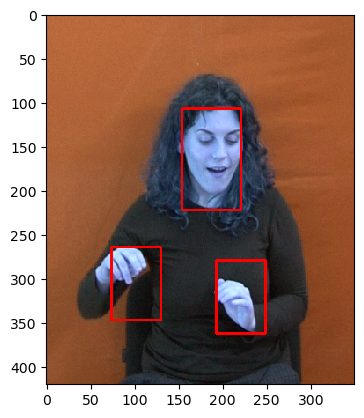

In [82]:
simple_tracker(limit=30,flow_type=False)

In [11]:
y,x,h,w = right_hand_coord

img1 = cv2.imread(f"part1 - GreekSignLanguage/{8}.png")
gray_img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2GRAY)
gray_img1 = gray_img1.astype(np.float32)/255 #normalize image

img2 = cv2.imread(f"part1 - GreekSignLanguage/{9}.png")
gray_img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2GRAY)
gray_img2 = gray_img2.astype(np.float32)/255 #normalize image

I1 = gray_img1[y:y+h,x:x+w]
I2 = gray_img2[y:y+h,x:x+w]

feats = cv2.goodFeaturesToTrack(I1,1000,0.1,0.1)
dx0 = np.zeros(I1.shape)
dy0 = np.zeros(I1.shape)

dx,dy = lk(I1,I2,feats,rho=5,epsilon=0.01,d_x0=dx0,d_y0=dy0)
        
print("Approximate movement of bounding box:",displ(dx,dy))

Approximate movement of bounding box: (-0.026946736755307555, 0.008324944998956068)


Παρατηρούμε ότι όταν προσπαθούμε να ακολουθήσουμε τα μέρη που αλλάζουν πολύ την μορφή τους 
στο σύνολο των frames (όπως το δεξί χέρι της κοπέλας που "απλώνει" και "μαζεύει") ο αλγόριθμος lk() αποτυγχάνει υπολογίσει καλά dx,dy ώστε να υπολογίσουμε την μετατόπιση του παραθύρου.
Για αυτό φταίει το γεγονός ότι στις δυο μορφές του χεριού (μαζεμένο-απλωμένο) βρίσκουμε διαφορετικά σημεία ενδιαφέροντος.

Αντίθετα, όταν ακολουθούμε το κεφάλι, που δεν αλλάζει σημαντικά την μορφή του, το bounding box ακολουθεί καλά την κίνηση της κοπέλας.

In [84]:
## pert 1.2.3
## multiscale lk()
def downscale_corners(feats):
    new_feats = []
    for x,y in feats[:,0,:].astype(int):
        new_feats.append([[int(x/2),int(y/2)]])
    return np.array(new_feats)
    
def multiscale_lk(I1,I2,rho,epsilon,scales):
    n = int(np.ceil(3*rho)*2+1)
    g1d = cv2.getGaussianKernel(n,rho)
    g2d = g1d @ g1d.T    ## lowpass filter
    
    feats = cv2.goodFeaturesToTrack(I2,1000,0.1,0.1)
    
    I1_scales = [I1]
    I2_scales = [I2]
    
    dx,dy = np.zeros(I1.shape),np.zeros(I1.shape)
    
    for i in range(scales-1): ## downsample I1,I2
        I1 = cv2.pyrDown(cv2.filter2D(I1,-1,g2d))
        I2 = cv2.pyrDown(cv2.filter2D(I2,-1,g2d))
        I1_scales.append(I1)
        I2_scales.append(I2)
    for i in range(scales): 
        I1 = I1_scales[i]
        I2 = I2_scales[i]
        feats = downscale_corners(feats)
        dx,dy = lk(I1,I2,feats,rho,epsilon,dx,dy)
    
    return dx,dy
        
        

Predicted movement of bounding box: (-0.7631890204524386, -0.7835712423349965)


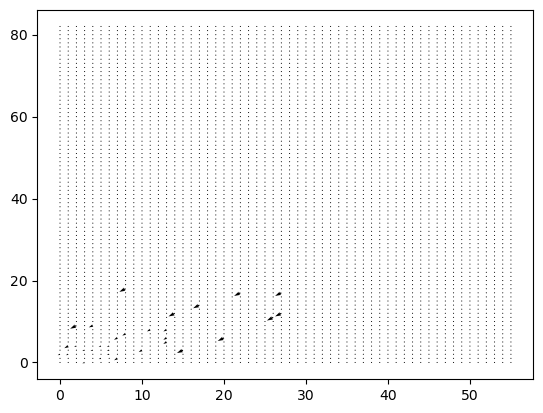

In [85]:
## testing
img = cv2.imread("part1 - GreekSignLanguage/1.png")
gray_img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
gray_img = gray_img.astype(np.float32)/255 #normalize image

## test on left hand
x,y,w,h = left_hand_coord
I1 = gray_img[y:y+h,x:x+w]
I2 = gray_img[y+1:y+h+1,x+1:x+w+1]

dx,dy = multiscale_lk(I1,I2,5,0.01,3)

print("Predicted movement of bounding box:",displ(dx,dy))

plt.quiver(dx, dy, angles='xy', scale=100)
plt.show()

In [97]:
## tracking left hand using simple lk()
def ms_tracker(limit=70):
    face_coord = [154,102,67,115]
    right_hand_coord = [93,272,56,83]
    left_hand_coord = [201,270,56,83]
    
    x = np.array([face_coord[0],right_hand_coord[0],left_hand_coord[0]])
    y = np.array([face_coord[1],right_hand_coord[1],left_hand_coord[1]])
    w = np.array([face_coord[2],right_hand_coord[2],left_hand_coord[2]])
    h = np.array([face_coord[3],right_hand_coord[3],left_hand_coord[3]])
    
    for frame in range(1,limit):
        img1 = cv2.imread(f"part1 - GreekSignLanguage/{frame}.png")
        gray_img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2GRAY)
        gray_img1 = gray_img1.astype(np.float32)/255 #normalize image

        img2 = cv2.imread(f"part1 - GreekSignLanguage/{frame+1}.png")
        gray_img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2GRAY)
        gray_img2 = gray_img2.astype(np.float32)/255 #normalize image
        
        
        for i in range(3):
            I1 = gray_img1[y[i]:y[i]+h[i],x[i]:x[i]+w[i]]
            I2 = gray_img2[y[i]:y[i]+h[i],x[i]:x[i]+w[i]]
            dx,dy = multiscale_lk(I1,I2,5,0.01,3)
            
            box_x, box_y = displ(dx,dy)
            x[i] += int(box_x)
            y[i] += int(box_y)
            
        for i in range(3):
            out = cv2.rectangle(img2, ((x[i]),(y[i])), ((x[i])+w[i], (y[i])+h[i]), (255,0,0), 2)

        print(f'Image: {frame}')
        print("Approximate movement of bounding box:",box_x,box_y)
        plt.imshow(img2)
        plt.show()

[154  93 201] [102 272 270] [67 56 56] [115  83  83]
Image: 1
Approximate movement of bounding box: -0.3384536500794281 0.19097653074488236


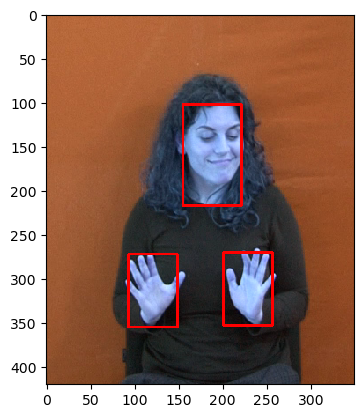

[155  93 201] [102 272 270] [67 56 56] [115  83  83]
Image: 2
Approximate movement of bounding box: -0.46201113666422405 0.0491648859243399


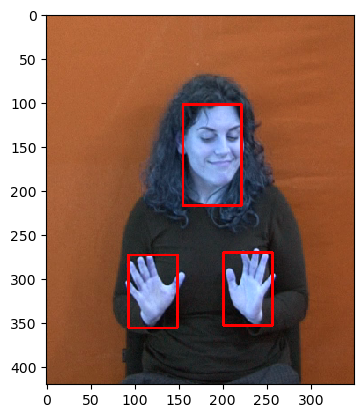

[155  93 201] [102 273 270] [67 56 56] [115  83  83]
Image: 3
Approximate movement of bounding box: -0.3974419907639588 0.005364966694331036


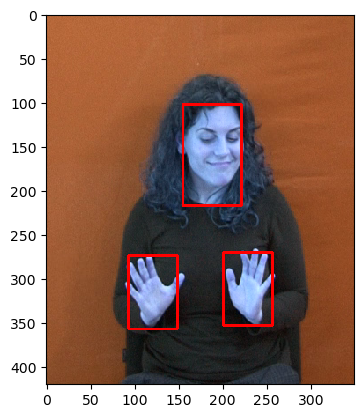

[155  93 201] [102 274 270] [67 56 56] [115  83  83]
Image: 4
Approximate movement of bounding box: -0.4714793133223223 -0.026989375531293703


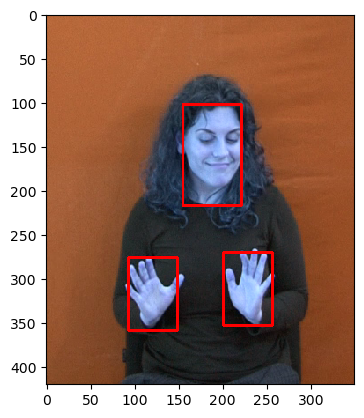

[155  93 201] [102 276 270] [67 56 56] [115  83  83]
Image: 5
Approximate movement of bounding box: -0.2990935761884426 0.2850525089213848


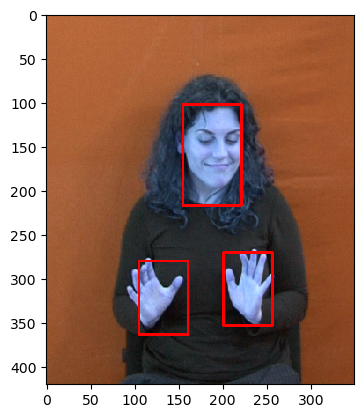

[155 105 201] [102 280 270] [67 56 56] [115  83  83]
Image: 6
Approximate movement of bounding box: -0.5626408098518113 0.8848073783433686


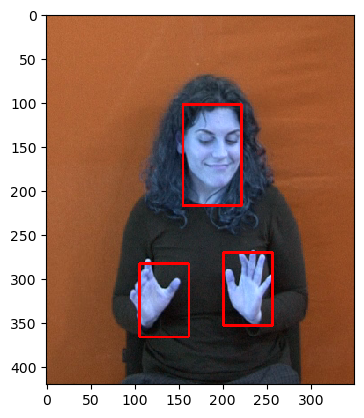

[155 106 201] [102 283 270] [67 56 56] [115  83  83]
Image: 7
Approximate movement of bounding box: -1.2536818872358022 1.7746923789290927


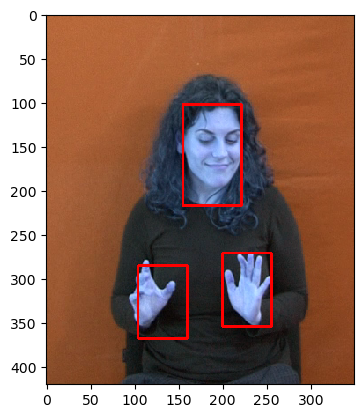

[155 104 200] [102 285 271] [67 56 56] [115  83  83]
Image: 8
Approximate movement of bounding box: -1.5090737563607322 1.8941223219443435


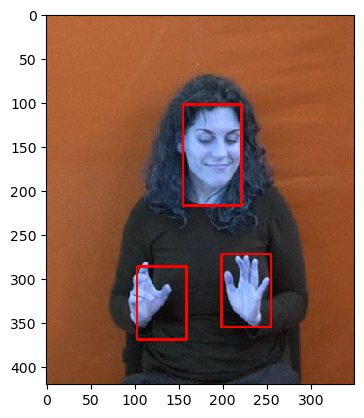

[155 103 199] [102 286 272] [67 56 56] [115  83  83]
Image: 9
Approximate movement of bounding box: -2.6070927358398195 3.061049607681243


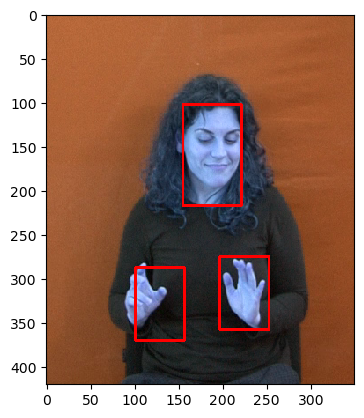

[155 101 197] [102 287 275] [67 56 56] [115  83  83]
Image: 10
Approximate movement of bounding box: -2.842809451165825 4.508492817457409


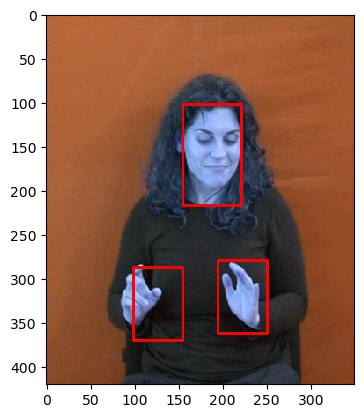

[155  99 195] [102 287 279] [67 56 56] [115  83  83]
Image: 11
Approximate movement of bounding box: -3.2628005203274077 3.563422913804823


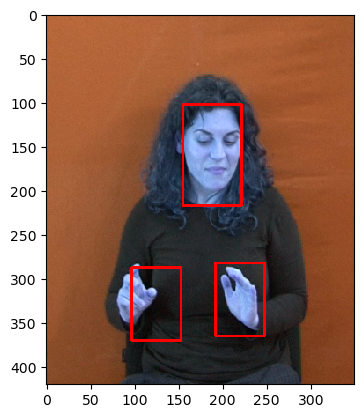

[155  97 192] [102 287 282] [67 56 56] [115  83  83]
Image: 12
Approximate movement of bounding box: -1.87397940644262 1.624285203877922


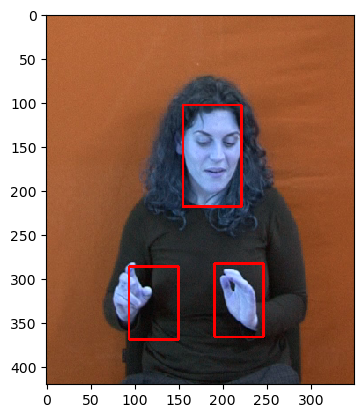

[155  94 191] [103 286 283] [67 56 56] [115  83  83]
Image: 13
Approximate movement of bounding box: -2.398116375525483 2.7735580486235563


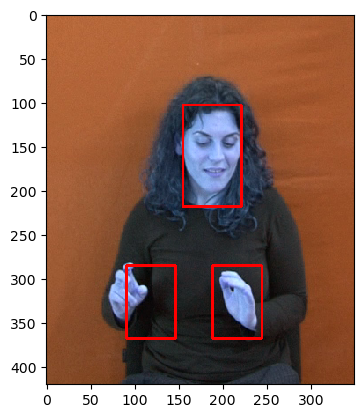

[155  91 189] [103 285 285] [67 56 56] [115  83  83]
Image: 14
Approximate movement of bounding box: -1.9658527620884625 2.994458693462294


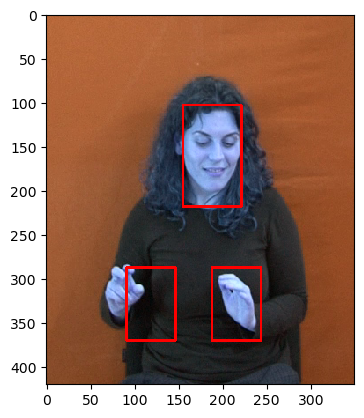

[155  91 188] [103 287 287] [67 56 56] [115  83  83]
Image: 15
Approximate movement of bounding box: -1.5287619611147352 2.102479540290994


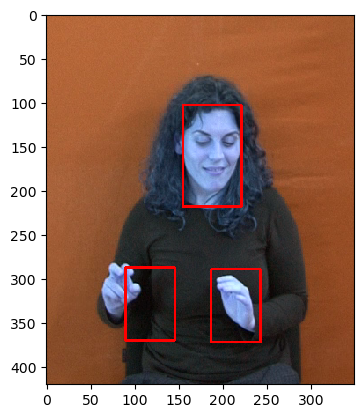

[155  90 187] [103 287 289] [67 56 56] [115  83  83]
Image: 16
Approximate movement of bounding box: -2.313082601936997 2.185387380682546


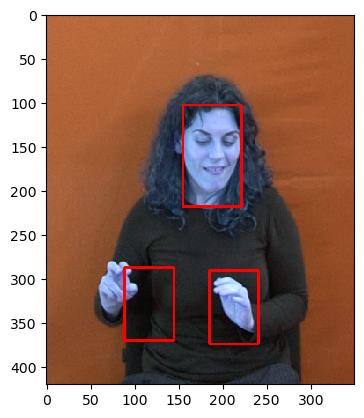

[155  89 185] [103 287 291] [67 56 56] [115  83  83]
Image: 17
Approximate movement of bounding box: -1.88880059033787 1.0726904306060974


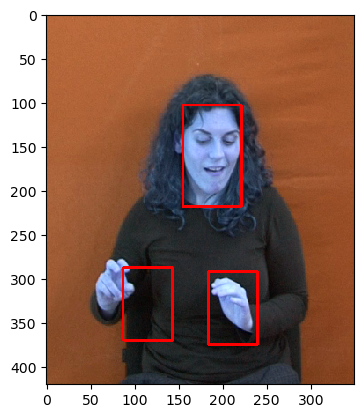

[155  87 184] [103 287 292] [67 56 56] [115  83  83]
Image: 18
Approximate movement of bounding box: -1.230667101049004 0.7535838937311831


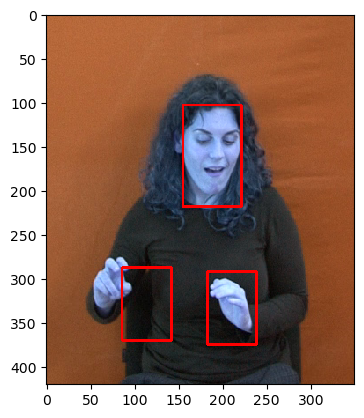

[155  86 183] [103 287 292] [67 56 56] [115  83  83]
Image: 19
Approximate movement of bounding box: -0.4538257550072828 0.9932639130059772


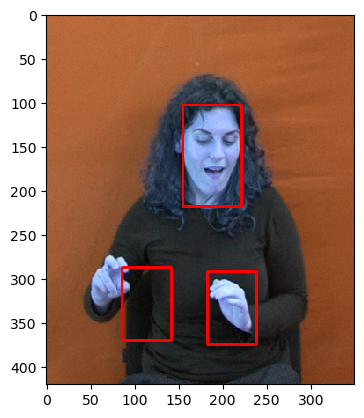

[155  86 183] [103 287 292] [67 56 56] [115  83  83]
Image: 20
Approximate movement of bounding box: 0.09756885018913089 0.7207105840473899


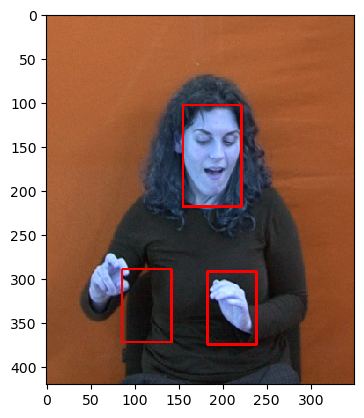

[155  86 183] [103 289 292] [67 56 56] [115  83  83]
Image: 21
Approximate movement of bounding box: 0.330459907630368 0.4161814908364895


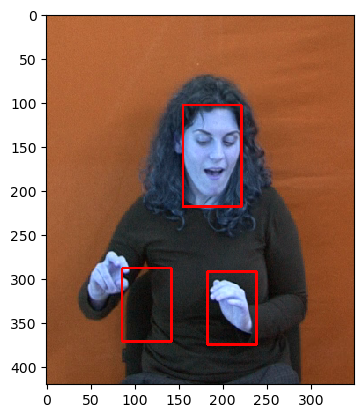

[155  86 183] [103 288 292] [67 56 56] [115  83  83]
Image: 22
Approximate movement of bounding box: 0.4225163903790728 -0.020936661655423162


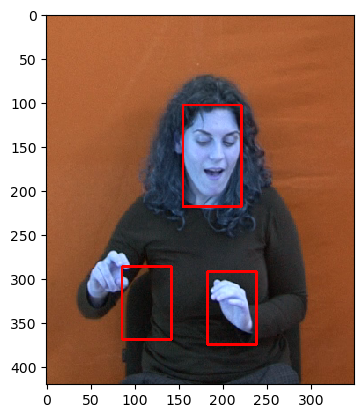

[155  86 183] [103 286 292] [67 56 56] [115  83  83]
Image: 23
Approximate movement of bounding box: 0.557672094438562 0.11389368321253164


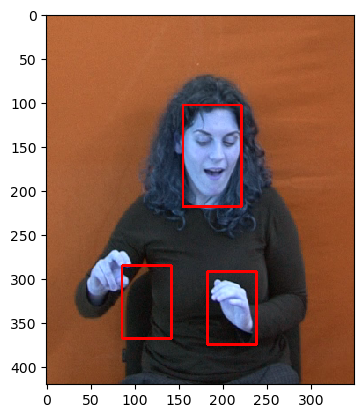

[155  86 183] [103 285 292] [67 56 56] [115  83  83]
Image: 24
Approximate movement of bounding box: 0.47557632088278395 0.04989755862703051


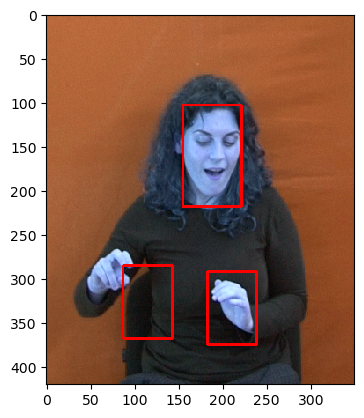

[155  87 183] [103 285 292] [67 56 56] [115  83  83]
Image: 25
Approximate movement of bounding box: 0.5758863556539451 -0.13435102628252923


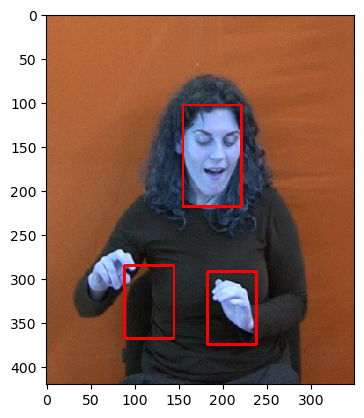

[155  89 183] [103 285 292] [67 56 56] [115  83  83]
Image: 26
Approximate movement of bounding box: 0.4485925575789618 0.03929778253449364


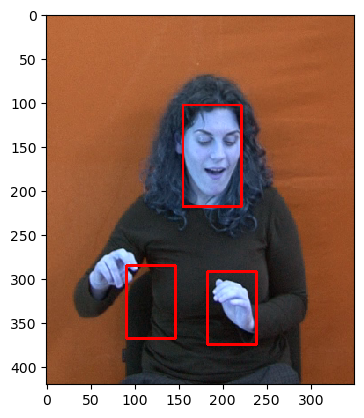

[155  91 183] [103 285 292] [67 56 56] [115  83  83]
Image: 27
Approximate movement of bounding box: 0.4694023261828824 0.017064826682127936


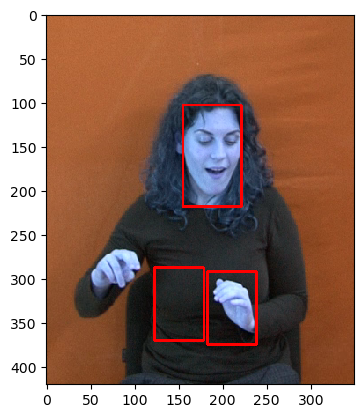

[155 123 183] [103 287 292] [67 56 56] [115  83  83]
Image: 28
Approximate movement of bounding box: 0.5615634369838659 -0.1319768156677938


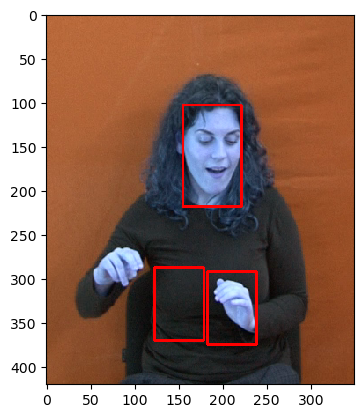

[155 123 183] [103 287 292] [67 56 56] [115  83  83]
Image: 29
Approximate movement of bounding box: 0.5808238132229034 -0.015459823485153295


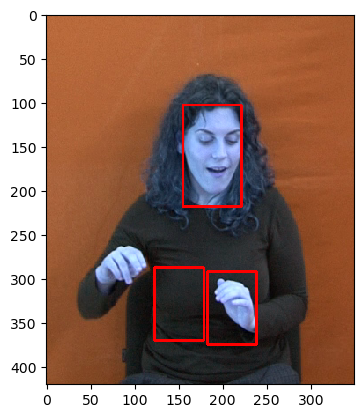

In [98]:
ms_tracker(limit=30)

In [47]:
## Part 2
import cv23_lab2_2_utils as p3
from scipy.ndimage import convolve1d
pics = 20
video = p3.read_video('./part2 - SpatioTemporal/handwaving/person01_handwaving_d2_uncomp.avi',pics,0)
print(video.shape)

(120, 160, 20)


In [48]:
## 2.1.1
def harrisDetector3D(video,sigma,t,scale,k):
    ns = int(2*np.ceil(3*sigma)+1)
    nt = int(2*np.ceil(3*t)+1)
    Gs = cv2.getGaussianKernel(ns,sigma)
    Gs = Gs.reshape(Gs.shape[0])## necessary for convolve1d
    Gt = cv2.getGaussianKernel(nt,t)
    Gt = Gt.reshape(Gt.shape[0])
    
    ## apply Gs on axis=0,1 (x,y) and Gt on axis=2 (t)
    smoothed_vid = convolve1d(convolve1d(convolve1d(video,Gs,axis=0),Gs,axis=1),Gt,axis=2)
    
    Ly,Lx,Lt = np.gradient(smoothed_vid)
    
    scaled_ns = int(2*np.ceil(3*scale*sigma))+1
    scaled_nt = int(2*np.ceil(3*scale*t)+1)
    scaled_Gs = cv2.getGaussianKernel(scaled_ns,scale*sigma)
    scaled_Gs = scaled_Gs.reshape(scaled_Gs.shape[0])
    scaled_Gt = cv2.getGaussianKernel(scaled_nt,scale*t)  
    scaled_Gt = scaled_Gt.reshape(scaled_Gt.shape[0])
    
    ## apply these 2 kernel to each Mij 
    M11 = convolve1d(convolve1d(convolve1d(Lx**2,scaled_Gs,axis=0),scaled_Gs,axis=1),scaled_Gt,axis=2)
    M12 = convolve1d(convolve1d(convolve1d(Lx*Ly,scaled_Gs,axis=0),scaled_Gs,axis=1),scaled_Gt,axis=2)
    M13 = convolve1d(convolve1d(convolve1d(Lx*Lt,scaled_Gs,axis=0),scaled_Gs,axis=1),scaled_Gt,axis=2)  
    M21 = convolve1d(convolve1d(convolve1d(Lx*Ly,scaled_Gs,axis=0),scaled_Gs,axis=1),scaled_Gt,axis=2)
    M22 = convolve1d(convolve1d(convolve1d(Ly**2,scaled_Gs,axis=0),scaled_Gs,axis=1),scaled_Gt,axis=2)
    M23 = convolve1d(convolve1d(convolve1d(Ly*Lt,scaled_Gs,axis=0),scaled_Gs,axis=1),scaled_Gt,axis=2)
    M31 = convolve1d(convolve1d(convolve1d(Lx*Lt,scaled_Gs,axis=0),scaled_Gs,axis=1),scaled_Gt,axis=2)    
    M32 = convolve1d(convolve1d(convolve1d(Ly*Lt,scaled_Gs,axis=0),scaled_Gs,axis=1),scaled_Gt,axis=2)
    M33 = convolve1d(convolve1d(convolve1d(Lt**2,scaled_Gs,axis=0),scaled_Gs,axis=1),scaled_Gt,axis=2)
        
    ## cornerness criterion
    detM = M11*(M22*M33-M23*M31)-M12*(M21*M33-M23*M31)+M13*(M21*M32-M22*M31)
    traceM = M11+M22+M33
    
    H = detM - k*(traceM)**3
    ## apply condition 2
    Cond = (H >= 0.2*H.max()).astype(int)
    H = H*Cond
    
    y, x, t = np.unravel_index(np.argsort(-1*H, axis=None), H.shape)
    scale = sigma*np.ones(x.shape)
    
    points = list(zip(x,y,t,scale))
    
    return np.array(points[:500])

In [6]:
points = harrisDetector3D(video,4,1.5,2,0.005)

In [7]:
## testing harrisDetector3D
%matplotlib inline
p3.show_detection(video,points, save_path = './Harris_frames/handwaving')

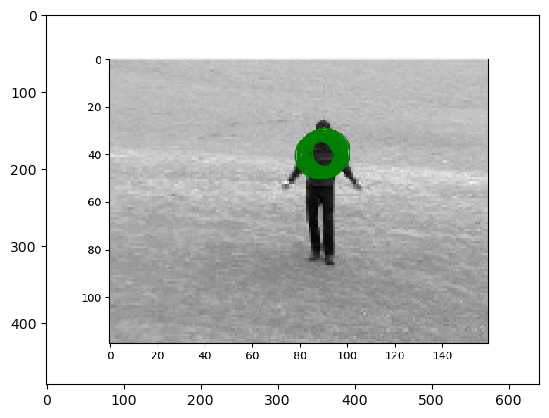

In [8]:
%matplotlib inline
f1 = cv2.imread("./Harris_frames/handwaving/frame13.png")
plt.imshow(f1)


In [50]:
## 2.1.2
def Gabor(video,sigma,t):
    ns = int(2*np.ceil(3*sigma)+1)
    Gs = cv2.getGaussianKernel(ns,sigma)
    Gs = Gs.reshape(Gs.shape[0])
    
    time = np.linspace(-2*t,2*t,int(4*t+1))
    omega = 4/t
    
    ## create hev, hod
    h_ev = (np.cos(2*np.pi*time*omega)*np.exp(-time**2/(2*t**2)))
    h_od = (np.sin(2*np.pi*time*omega)*np.exp(-time**2/(2*t**2)))
    
    ## normalize 
    h_ev = h_ev/np.linalg.norm(h_ev,ord=1)
    h_od = h_od/np.linalg.norm(h_od,ord=1)
    
    Iev = convolve1d(convolve1d(convolve1d(video,Gs,axis=0),Gs,axis=1),h_ev,axis=2)
    Iod = convolve1d(convolve1d(convolve1d(video,Gs,axis=0),Gs,axis=1),h_od,axis=2)
    
    H = Iev**2 + Iod**2
    
    ## apply condition 2
    Cond = (H >= 0.2*H.max()).astype(int)
    H = H*Cond
    
    y, x, t = np.unravel_index(np.argsort(-1*H, axis=None), H.shape)
    scale = sigma*np.ones(x.shape)
    
    points = list(zip(x,y,t,scale))
    
    return np.array(points[:500])

In [10]:
points = Gabor(video,4,1.5)
Vx,Vy,Vt = np.gradient(video)

In [12]:
## testing harrisDetector3D
%matplotlib inline
p3.show_detection(video,points, save_path = './Gabor_frames/handwaving')

In [51]:
## testing on the 2 other sets
v1 = p3.read_video('./part2 - SpatioTemporal/running/person01_running_d1_uncomp.avi',pics,0)
v2 = p3.read_video('./part2 - SpatioTemporal/walking/person04_walking_d1_uncomp.avi',pics,0)

p1_harris = harrisDetector3D(v1,4,1.5,2,0.005)
p1_gabor = Gabor(v1,4,1.5)

p2_harris = harrisDetector3D(v2,4,1.5,2,0.005)
p2_gabor = Gabor(v2,4,1.5)

%matplotlib inline
p3.show_detection(v1,p1_harris, save_path = './Harris_frames/running')
p3.show_detection(v2,p2_harris, save_path = './Harris_frames/walking')

%matplotlib inline
p3.show_detection(v1,p1_gabor, save_path = './Gabor_frames/running')
p3.show_detection(v2,p2_gabor, save_path = './Gabor_frames/walking')


In [102]:
## Part 2

def out(feat):
    sigma = feat[3]
    return ((feat[1]-sigma//2)<0) or ((feat[1]+sigma//2)>120) or ((feat[0]-sigma//2)<0) or ((feat[0]+sigma//2)>160)

## part 2.2.1
def hist_desc(video,feats,desc_type,nbins):
    '''
    according to selected method, isolate an (sigma x sigma) area around feature point
    and calculate the histogram of this area (a histrographic distription of the area)
    
    HOG: this area contains information about the spatial gradient
    HOF: this area contains information about the optical flow
    '''
    
    result = []
    if desc_type == 'HOG' or desc_type=='HOG/HOF':
        vy,vx,vt = np.gradient(video)
        for feat in feats:
            if not out(feat):
                sigma = int(feat[3])
                ## pick all points +-sigma/2 from a feature point detected in time t
                Gx = vx[int(feat[1]-sigma//2):int(feat[1]+sigma//2),int(feat[0]-sigma//2):int(feat[0]+sigma//2),int(feat[2])]
                Gy = vy[int(feat[1]-sigma//2):int(feat[1]+sigma//2),int(feat[0]-sigma//2):int(feat[0]+sigma//2),int(feat[2])]
                desc = p3.orientation_histogram(Gx,Gy,nbins,np.array([sigma,sigma]))
                result.append(desc)
    if desc_type == 'HOF' or desc_type == 'HOG/HOF':
        opt_flow = cv2.DualTVL1OpticalFlow_create()
        ## find the flow between all the pairs of frames --> dx,dy 3D arrays
        dx = []
        dy = []
        for i in range(video.shape[2]-1):
            frame1 = (video[:,:,i].astype(np.uint8))*241
            frame2 = (video[:,:,i+1].astype(np.uint8))*241
            flow = opt_flow.calc(frame1,frame2,None)
            dx.append(flow[:,:,1])
            dy.append(flow[:,:,0])
        ## for every feature extraxt an (sigma x sigma) area around it
        for feat in feats:
            if not out(feat) and feat[2]!=19:
                sigma = int(feat[3])
                ## pick all points +-sigma/2 from a feature point detected in time t
                Gx = dx[int(feat[2])][int(feat[1]-sigma//2):int(feat[1]+sigma//2),int(feat[0]-sigma//2):int(feat[0]+sigma//2)]
                Gy = dy[int(feat[2])][int(feat[1]-sigma//2):int(feat[1]+sigma//2),int(feat[0]-sigma//2):int(feat[0]+sigma//2)]
                desc = p3.orientation_histogram(Gx,Gy,nbins,np.array([sigma,sigma]))
                result.append(desc)
                
    return np.array(result)

In [103]:
## test the descriptor
hog_test = hist_desc(video,points,'HOF',5)
#hof_test = hist_desc(video,points,'HOF',5)

In [104]:
### part 2.3
## part 2.3.1
import os

file = open('./part2 - SpatioTemporal/traininng_videos.txt')
lines = file.readlines()
file.close()
train_set = []
for name in lines:
    if name[-1] == '\n':
        train_set.append(name.replace('\n',''))
    else:
        train_set.append(name)
        
dir = os.listdir('./part2 - SpatioTemporal/all_videos')

test_set = []

for vid in dir:
    if vid not in train_set:
        test_set.append(vid)

training_vids = []
testing_vids = []
for name in train_set:
    training_vids.append(p3.read_video(f'./part2 - SpatioTemporal/all_videos/{name}'))
for name in test_set:
    testing_vids.append(p3.read_video(f'./part2 - SpatioTemporal/all_videos/{name}'))
print(len(dir))
print(len(test_set),len(testing_vids))
print(len(train_set),len(training_vids))

48
12 12
36 36


In [105]:
from tqdm import tqdm

In [56]:
## part 2.3.2
train_desc = []
test_desc = []

for v in tqdm(training_vids):
    feats = harrisDetector3D(v,4,1.5,2,0.005)
    train_desc.append(hist_desc(v,feats,'HOG',8))

for v in tqdm(testing_vids):
    feats = harrisDetector3D(v,4,1.5,2,0.005)
    test_desc.append(hist_desc(v,feats,'HOG',8))

bow_train,bow_test = p3.bag_of_words(train_desc,test_desc,50)

100%|██████████████████████████████████████████████████████████████████████████████████| 12/12 [03:00<00:00, 15.07s/it]


In [57]:
print(bow_train.shape)
print(bow_test.shape)

(36, 50)
(12, 50)


In [61]:
# Train an SVM to classify videos
train_labels = list(np.zeros(12)) + list(np.ones(12)) + list(2*np.ones(12))
test_labels = list(np.zeros(4)) + list(np.ones(4)) + list(2*np.ones(4))

acc, pred = p3.svm_train_test(bow_train, train_labels, bow_test, test_labels)

print(f'Using HarrisDetector and HOG descriptor, acc:{acc}')


Using HarrisDetector and HOG descriptor, acc:0.25


In [ ]:
### remaiming: Testing Gabor/Harris and HOG-HOF-HOG/HOF 
descs = ['HOG','HOF','HOG/HOF']
detectors = ['Harris','Gabor']

for desc in descs:
    for det in detectors:
        if det == 'Harris':
            train_desc = []
            test_desc = []
            for v in tqdm(training_vids):
                feats = harrisDetector3D(v,4,1.5,2,0.005)
                train_desc.append(hist_desc(v,feats,desc,8))
            for v in tqdm(testing_vids):
                feats = harrisDetector3D(v,4,1.5,2,0.005)
                test_desc.append(hist_desc(v,feats,desc,8))
            bow_train,bow_test = p3.bag_of_words(train_desc,test_desc,50)
            train_labels = list(np.zeros(12)) + list(np.ones(12)) + list(2*np.ones(12))
            test_labels = list(np.zeros(4)) + list(np.ones(4)) + list(2*np.ones(4))
            acc, pred = p3.svm_train_test(bow_train, train_labels, bow_test, test_labels)
            print(f'Using {det} and {desc}, acc:{acc}')
        elif det == 'Gabor':
            train_desc = []
            test_desc = []
            for v in tqdm(training_vids):
                feats = harrisDetector3D(v,4,1.5,2,0.005)
                train_desc.append(hist_desc(v,feats,desc,8))
            for v in tqdm(testing_vids):
                feats = harrisDetector3D(v,4,1.5,2,0.005)
                test_desc.append(hist_desc(v,feats,desc,8))
            bow_train,bow_test = p3.bag_of_words(train_desc,test_desc,50)
            train_labels = list(np.zeros(12)) + list(np.ones(12)) + list(2*np.ones(12))
            test_labels = list(np.zeros(4)) + list(np.ones(4)) + list(2*np.ones(4))
            acc, pred = p3.svm_train_test(bow_train, train_labels, bow_test, test_labels)
            print(f'Using {det} and {desc}, acc: {acc}')

        
        

100%|██████████████████████████████████████████████████████████████████████████████████| 12/12 [03:02<00:00, 15.24s/it]


Using Harris and HOG, acc:0.3333333333333333


100%|██████████████████████████████████████████████████████████████████████████████████| 12/12 [02:50<00:00, 14.23s/it]


Using Gabor and HOG, acc: 0.25


100%|█████████████████████████████████████████████████████████████████████████████████| 12/12 [40:21<00:00, 201.82s/it]


Using Harris and HOF, acc:0.5833333333333334


 39%|██████████████████████████████▋                                                | 14/36 [50:24<1:29:23, 243.79s/it]

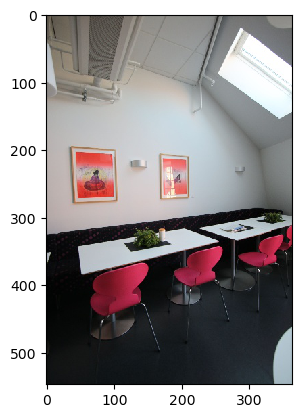

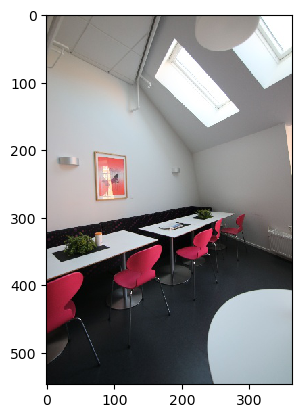

In [2]:
### Part 3
## step 0
img1 = cv2.imread('./part3 - ImageStitching/img1_ratio01.jpg')
img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)
plt.imshow(img1)
plt.show()
img2 = cv2.imread('./part3 - ImageStitching/img2_ratio01.jpg')
img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)
plt.imshow(img2)
plt.show()

gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

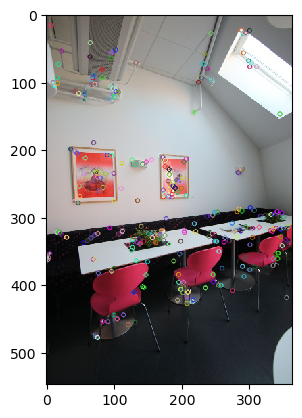

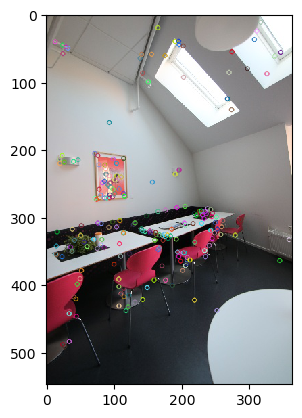

In [3]:
## step 1: extract SIFT feats and descriptors
sift = cv2.xfeatures2d.SIFT_create()

feats1, desc1 = sift.detectAndCompute(img1,None)
sift_img1 = cv2.drawKeypoints(img1,feats1,0)
plt.imshow(sift_img1)
plt.show()

feats2, desc2 = sift.detectAndCompute(img2,None)
sift_img2 = cv2.drawKeypoints(img2,feats2,0)
plt.imshow(sift_img2)
plt.show()

In [24]:
## step 2-3: match points between images and apply Lowe's ratio
def FLANN_matching(img1,img2):
    sift = cv2.xfeatures2d.SIFT_create()
    kp1, desc1 = sift.detectAndCompute(img1,None)
    kp2, desc2 = sift.detectAndCompute(img2,None)
    
    FLANN_INDEX_KDTREE = 0
    index_params = dict(algorithm = FLANN_INDEX_KDTREE,trees=5)
    search_params = {}
    
    ## match feats
    flann = cv2.FlannBasedMatcher(index_params,search_params)
    matches = flann.knnMatch(desc1,desc2,k=2)
    
    ## filter matches using Lowe's ratio test
    ratio = 0.5
    good_matches = []
    for m,n in matches:
        if m.distance < ratio*n.distance:
            good_matches.append(m)
            
    ## draw results
    img_matches = np.empty((max(img1.shape[0],img2.shape[0]),img1.shape[1]+img2.shape[1],3),dtype=np.uint8)
    cv2.drawMatches(img1,kp1,img2,kp2,good_matches,img_matches,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    #plt.imshow(img_matches)
    #plt.show()
    
    ## calculating xA,xB vectors -> necessary for calculating homography
    img1_pts = np.float32([kp1[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    img2_pts = np.float32([kp2[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    
    return img1_pts, img2_pts
    
    
    
    

In [25]:
xA,xB = FLANN_matching(img1,img2)

In [26]:
### step4: using RANSAC calculate homography between the 2 pictures
H, mask = cv2.findHomography(xA,xB,cv2.RANSAC,5.0)
H

array([[ 1.68840770e+00,  3.17756707e-02, -1.97087627e+02],
       [ 4.71625050e-01,  1.42720175e+00, -1.08051481e+02],
       [ 1.83556870e-03,  1.26119089e-05,  1.00000000e+00]])

In [27]:
def projectionImage(img,H):
    h,w,d = img.shape
    src_pts = np.float32([[[0,0]],[[w-1,0]],[[w-1,h-1]],[[0,h-1]]])
    dst_pts = cv2.perspectiveTransform(src_pts,H)
    
    A = dst_pts[0][0]  ## top left coords
    B = dst_pts[1][0]
    C = dst_pts[2][0]
    D = dst_pts[3][0]
    
    ## calculate height and width of the resulted image
    AD = np.sqrt((A[0]-D[0])**2 + (A[1]-D[1])**2)
    BC = np.sqrt((B[0]-C[0])**2 + (B[1]-C[1])**2)
    heigth = int(max(AD,BC))
    
    AB = np.sqrt((A[0]-B[0])**2 + (A[1]-B[1])**2)
    DC = np.sqrt((D[0]-C[0])**2 + (D[1]-C[1])**2)
    width = int(max(AB,DC))
    
    ## find image transformer: top_left -> 0,0 + homographic transformation
    move = np.float32([[1,0,-A[0]],
                       [0,1,-A[1]],
                       [0,0,1]])
    M = np.matmul(move,H)
    
    img1_warped = cv2.warpPerspective(img,M,(width,heigth))
    return img1_warped, A


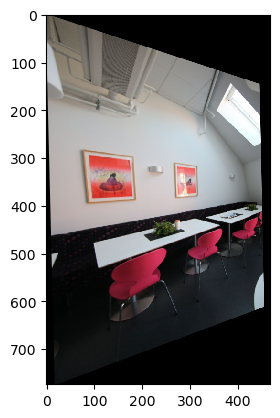

In [28]:
img1_warped,img1_topleft_coords=projectionImage(img1,H)
plt.imshow(img1_warped)

In [33]:
### step6: stitch images
def mergeWarpedImages(img1_warped, img2, img1_topleft_coords):
    h,w,d = img2.shape
    ## move img2 according to topleft coords
    width = w-int(img1_topleft_coords[0])
    heigth = h-int(img1_topleft_coords[1])
    
    M = np.float32([[1,0,-img1_topleft_coords[0]],
                    [0,1,-img1_topleft_coords[1]],
                    [0,0,1]])
    img2_warped = cv2.warpPerspective(img2,M,(width,heigth))
    
    ## find the size of the result
    heigth = max(img1_warped.shape[0],img2_warped.shape[0])
    width = max(img1_warped.shape[1],img2_warped.shape[1])
    
    ## bring both images to same size
    img1_final = cv2.warpPerspective(img1_warped,np.identity(3),(width,heigth))
    img2_final = cv2.warpPerspective(img2_warped,np.identity(3),(width,heigth))
    
    ## delete those pixels that overlap
    condition = (img2_final > 0)
    img1_final = np.where(condition,0,img1_final)
    
    return img1_final + img2_final
    

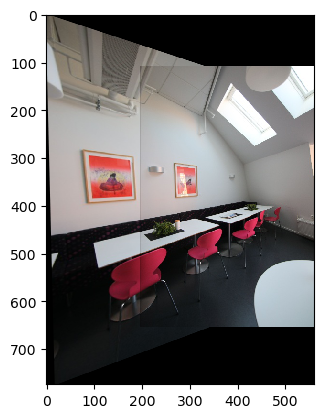

In [34]:
res = mergeWarpedImages(img1_warped, img2, img1_topleft_coords)
plt.imshow(res)

In [35]:
## combine the above prework
def stichImages(img1,img2):
    ## step1-2-3: extract SIFT keypoints and descriptors, match points and apply Lowe's ratio
    img1_pts,img2_pts = FLANN_matching(img1,img2)
    ## step4: using RANSAC calculate homography between the 2 pictures
    H, mask = cv2.findHomography(img1_pts,img2_pts,cv2.RANSAC,5.0)
    ## step5: project img1 to the space of img2
    img1_warped, img1_topleft_coords = projectionImage(img1,H)
    ## step6: merge the 2 images to a final
    res = mergeWarpedImages(img1_warped, img2, img1_topleft_coords)
    return res
    

In [36]:
## test for several images
img1 = cv2.imread('./part3 - ImageStitching/img1_ratio01.jpg')
img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)

img2 = cv2.imread('./part3 - ImageStitching/img2_ratio01.jpg')
img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)

img3 = cv2.imread('./part3 - ImageStitching/img3_ratio01.jpg')
img3 = cv2.cvtColor(img3,cv2.COLOR_BGR2RGB)

img4 = cv2.imread('./part3 - ImageStitching/img4_ratio01.jpg')
img4 = cv2.cvtColor(img4,cv2.COLOR_BGR2RGB)

img5 = cv2.imread('./part3 - ImageStitching/img5_ratio01.jpg')
img5 = cv2.cvtColor(img5,cv2.COLOR_BGR2RGB)

img6 = cv2.imread('./part3 - ImageStitching/img6_ratio01.jpg')
img6 = cv2.cvtColor(img6,cv2.COLOR_BGR2RGB)

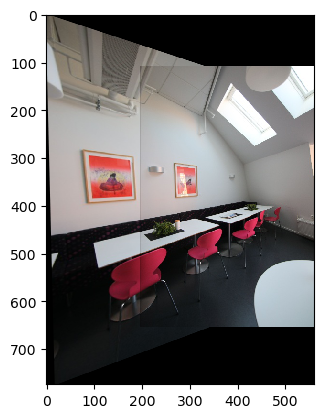

In [37]:
img12 = stichImages(img1,img2)
plt.imshow(img12)

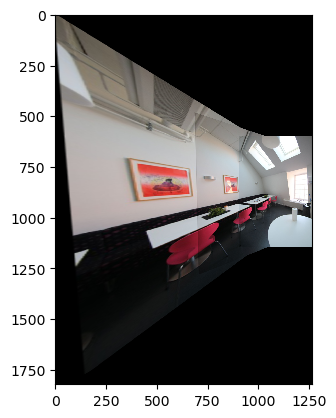

In [38]:
img123 = stichImages(img12,img3)
plt.imshow(img123)

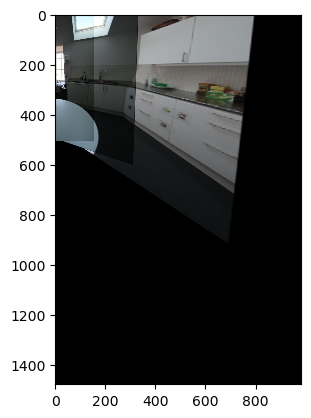

In [44]:
img65 = stichImages(img6,img5)
img654 = stichImages(img65,img4)
plt.imshow(img654)

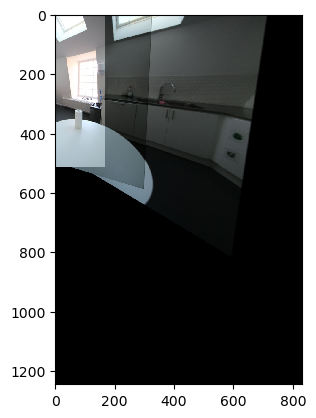

In [46]:
img543= stichImages(img54,img3)
plt.imshow(img543)

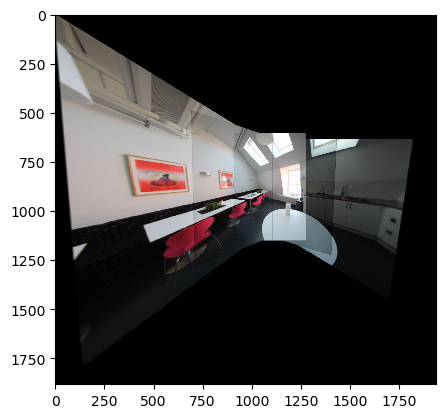

In [41]:
img_all = stichImages(img123,img543)
plt.imshow(img_all)